In [ ]:
### 1 – Installation (exécuter une seule fois)
!pip install -q torch accelerate transformers datasets evaluate scikit-learn \
              matplotlib seaborn plotly xgboost lightgbm shap lime \
              huggingface_hub peft bitsandbytes loguru


In [ ]:
### 2 – Imports & répertoires
import os, re, time, json
from pathlib import Path
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
from loguru import logger
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder, label_binarize
from sklearn.metrics import (
    classification_report, accuracy_score, precision_score, recall_score,
    f1_score, roc_curve, auc, confusion_matrix
)
from sklearn.svm import LinearSVC
from sklearn.calibration import CalibratedClassifierCV
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
import joblib

import shap, lime.lime_text
import plotly.io as pio ; pio.renderers.default = "notebook"

from datasets import load_dataset, Dataset
import torch, evaluate
from transformers import (
    AutoTokenizer, AutoModelForSequenceClassification,
    DataCollatorWithPadding, Trainer, TrainingArguments,
    EarlyStoppingCallback, set_seed
)

# Répertoires de cache
Path("lastmodels_tab").mkdir(exist_ok=True)
Path("lasttfidf").mkdir(exist_ok=True)
set_seed(42)


2025-04-27 13:13:43.531499: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-04-27 13:13:43.531600: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-04-27 13:13:43.594572: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-27 13:13:43.726157: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-04-27 13:13:45.194092: W tensorflow/compiler/tf2

In [ ]:
### 3 – Chargement & fusion des données
# Twitter
ds_train = load_dataset("zeroshot/twitter-financial-news-sentiment", split="train")
ds_val   = load_dataset("zeroshot/twitter-financial-news-sentiment", split="validation")
df1 = pd.concat([ds_train.to_pandas(), ds_val.to_pandas()], ignore_index=True)
df1["label"] = df1["label"].map({0:"negative",1:"positive",2:"neutral"})
df1["input"] = df1["text"]

# FinGPT
ds2 = load_dataset("FinGPT/fingpt-sentiment-train", split="train")
df2 = ds2.to_pandas()
def simplify(lbl:str)->str:
    lbl = lbl.lower()
    if "very positive" in lbl or "strongly positive" in lbl: return "very positive"
    if "positive" in lbl:      return "positive"
    if "very negative" in lbl or "strongly negative" in lbl: return "very negative"
    if "negative" in lbl:      return "negative"
    return "neutral"
df2["label"] = df2["output"].apply(simplify)
df2          = df2[["input","label"]]

df_combined  = pd.concat([df1[["input","label"]], df2], ignore_index=True)
print(df_combined["label"].value_counts())


Extracting data files:   0%|          | 0/2 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

/usr/local/lib/python3.11/dist-packages/datasets/download/streaming_download_manager.py:765: FutureWarning:

The 'verbose' keyword in pd.read_csv is deprecated and will be removed in a future version.



Generating validation split: 0 examples [00:00, ? examples/s]

/usr/local/lib/python3.11/dist-packages/datasets/download/streaming_download_manager.py:765: FutureWarning:

The 'verbose' keyword in pd.read_csv is deprecated and will be removed in a future version.



Extracting data files:   0%|          | 0/1 [00:00<?, ?it/s]

Generating train split:   0%|          | 0/76772 [00:00<?, ? examples/s]

label
neutral     36959
positive    32908
negative    18836
Name: count, dtype: int64


In [ ]:
### 4 – Nettoyage basique + split
def clean_text(txt:str)->str:
    txt = re.sub(r"http\S+|@\w+|[^a-zA-Z0-9\s]", " ", txt)
    return txt.lower().strip()
df_combined["input"] = df_combined["input"].astype(str).apply(clean_text)

train_df, tmp = train_test_split(df_combined, test_size=0.30,
                                 stratify=df_combined["label"], random_state=42)
val_df, test_df = train_test_split(tmp, test_size=2/3,
                                   stratify=tmp["label"], random_state=42)
print(f"Train {len(train_df)}  |  Val {len(val_df)}  |  Test {len(test_df)}")


Train 62092  |  Val 8870  |  Test 17741


In [ ]:
### 5 – Vectorisation TF‑IDF  (avec cache robuste)
from sklearn.exceptions import NotFittedError
from pathlib import Path
import joblib, re
from sklearn.feature_extraction.text import TfidfVectorizer

vec_path = Path("lasttfidf/tfidf_vect.joblib")
vec_path.parent.mkdir(exist_ok=True)

def _is_fitted(vect) -> bool:
    """Renvoie True si le vectorizer est déjà entraîné."""
    try:
        vect.transform(["test"])           # essaye une transfo factice
        return True
    except NotFittedError:
        return False

# ─── Chargement ou entraînement du vectorizer ────────────────────────────────
if vec_path.exists():
    vectorizer = joblib.load(vec_path)
    if _is_fitted(vectorizer):
        logger.info("✓ TF‑IDF vectorizer rechargé depuis le cache")
    else:
        logger.warning("⟳ Vectorizer trouvé mais non fitté ; on le ré‑entraîne")
        vectorizer.fit(train_df["input"])
        joblib.dump(vectorizer, vec_path)
        logger.info("✓ Vectorizer ré‑entraîné et sauvegardé")
else:
    logger.info("⏳ Entraînement initial du TF‑IDF vectorizer…")
    vectorizer = TfidfVectorizer(max_features=10_000, ngram_range=(1,2))
    vectorizer.fit(train_df["input"])
    joblib.dump(vectorizer, vec_path)
    logger.info("✓ Vectorizer sauvegardé → %s", vec_path.as_posix())

# ─── Création des matrices ----------------------------------------------------
X_train = vectorizer.transform(train_df["input"])
X_val   = vectorizer.transform(val_df["input"])
X_test  = vectorizer.transform(test_df["input"])

# ─── Encodage des labels ------------------------------------------------------
le_path = Path("lasttfidf/label_encoder.joblib")
if le_path.exists():
    le = joblib.load(le_path)
else:
    le = LabelEncoder().fit(train_df["label"])
    joblib.dump(le, le_path)

y_train = le.transform(train_df["label"])
y_val   = le.transform(val_df["label"])
y_test  = le.transform(test_df["label"])
classes = le.classes_

logger.success("Cellule 5 terminée – plus de NotFittedError ✅")


2025-04-27 13:16:26.808 | INFO     | __main__:<module>:29 - ⏳ Entraînement initial du TF‑IDF vectorizer…
2025-04-27 13:16:29.299 | INFO     | __main__:<module>:33 - ✓ Vectorizer sauvegardé → %s
2025-04-27 13:16:30.990 | SUCCESS  | __main__:<module>:53 - Cellule 5 terminée – plus de NotFittedError ✅


In [ ]:
### 6 – Fonctions utilitaires
def store_metrics(name, y_true, y_pred, store:list):
    store.append({
        "Modèle":name,
        "Accuracy":accuracy_score(y_true,y_pred),
        "F1 macro":f1_score(y_true,y_pred,average="macro"),
        "Precision macro":precision_score(y_true,y_pred,average="macro"),
        "Recall macro":recall_score(y_true,y_pred,average="macro")
    })
    print(f"\n=== {name} ===")
    print(classification_report(y_true, y_pred, target_names=classes, digits=3))

def roc_plotly(name, y_score):
    y_bin = label_binarize(y_test, classes=range(len(classes)))
    fig = go.Figure()
    for i, lbl in enumerate(classes):
        fpr, tpr, _ = roc_curve(y_bin[:,i], y_score[:,i])
        roc_auc = auc(fpr,tpr)
        fig.add_trace(go.Scatter(x=fpr, y=tpr, mode="lines",
                                 name=f"{lbl} (AUC {roc_auc:.2f})"))
    fig.add_shape(type="line", x0=0,y0=0,x1=1,y1=1,
                  line=dict(dash="dash",color="gray"))
    fig.update_layout(title=f"ROC – {name}",
                      xaxis_title="FPR", yaxis_title="TPR", width=700, height=500)
    fig.show()


In [ ]:
### 7 – Entraînement / chargement des modèles classiques
metrics = []

# SVM (linear) -----------------------------------------------------------------
svm_path, svm_cal_path = Path("lastmodels_tab/linear_svc.joblib"), Path("lastmodels_tab/linear_svc_cal.joblib")
if svm_path.exists() and svm_cal_path.exists():
    svm_best  = joblib.load(svm_path)
    svm_calib = joblib.load(svm_cal_path)
else:
    svm_cv = GridSearchCV(LinearSVC(),{"C":[0.01,0.1,1,10]},
                          cv=3, scoring="f1_macro", n_jobs=-1).fit(X_train,y_train)
    svm_best  = svm_cv.best_estimator_
    svm_calib = CalibratedClassifierCV(svm_best, cv=3).fit(X_train,y_train)
    joblib.dump(svm_best,  svm_path)
    joblib.dump(svm_calib, svm_cal_path)

store_metrics("SVM", y_test, svm_best.predict(X_test), metrics)

# Random Forest -----------------------------------------------------------------
rf_path = Path("lastmodels_tab/random_forest.joblib")
if rf_path.exists():
    rf_best = joblib.load(rf_path)
else:
    rf_cv   = GridSearchCV(RandomForestClassifier(),
                           {"n_estimators":[100,200],"max_depth":[None,10,20]},
                           cv=3, scoring="f1_macro", n_jobs=-1).fit(X_train,y_train)
    rf_best = rf_cv.best_estimator_
    joblib.dump(rf_best, rf_path)
store_metrics("Random Forest", y_test, rf_best.predict(X_test), metrics)

# XGBoost -----------------------------------------------------------------------
xgb_path = Path("lastmodels_tab/xgboost.joblib")
if xgb_path.exists():
    xgb_best = joblib.load(xgb_path)
else:
    xgb_cv   = GridSearchCV(XGBClassifier(tree_method="hist",use_label_encoder=False,eval_metric="mlogloss"),
                            {"n_estimators":[100,200]}, cv=3,
                            scoring="f1_macro", n_jobs=-1).fit(X_train,y_train)
    xgb_best = xgb_cv.best_estimator_
    joblib.dump(xgb_best, xgb_path)
store_metrics("XGBoost", y_test, xgb_best.predict(X_test), metrics)

# LightGBM ----------------------------------------------------------------------
lgb_path = Path("lastmodels_tab/lightgbm.joblib")
if lgb_path.exists():
    lgb_best = joblib.load(lgb_path)
else:
    lgb_cv   = GridSearchCV(LGBMClassifier(),
                            {"n_estimators":[100,200]}, cv=3,
                            scoring="f1_macro", n_jobs=-1).fit(X_train,y_train)
    lgb_best = lgb_cv.best_estimator_
    joblib.dump(lgb_best, lgb_path)
store_metrics("LightGBM", y_test, lgb_best.predict(X_test), metrics)

# Voting soft -------------------------------------------------------------------
vote_path = Path("lastmodels_tab/voting_soft.joblib")
if vote_path.exists():
    voting = joblib.load(vote_path)
else:
    voting = VotingClassifier(
        estimators=[("svm",svm_calib),("rf",rf_best),
                   ("xgb",xgb_best),("lgbm",lgb_best)],
        voting="soft", n_jobs=-1).fit(X_train,y_train)
    joblib.dump(voting, vote_path)
store_metrics("Voting", y_test, voting.predict(X_test), metrics)

# Tableau récapitulatif
results_df = pd.DataFrame(metrics).round(3)
display(results_df)


/usr/local/lib/python3.11/dist-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_classes.py:32: Futu


=== SVM ===
              precision    recall  f1-score   support

    negative      0.877     0.853     0.865      3767
     neutral      0.910     0.937     0.923      7392
    positive      0.901     0.886     0.893      6582

    accuracy                          0.900     17741
   macro avg      0.896     0.892     0.894     17741
weighted avg      0.900     0.900     0.900     17741


=== Random Forest ===
              precision    recall  f1-score   support

    negative      0.968     0.774     0.860      3767
     neutral      0.920     0.964     0.941      7392
    positive      0.877     0.931     0.903      6582

    accuracy                          0.911     17741
   macro avg      0.922     0.890     0.902     17741
weighted avg      0.914     0.911     0.910     17741



/usr/local/lib/python3.11/dist-packages/xgboost/sklearn.py:1395: UserWarning:

`use_label_encoder` is deprecated in 1.7.0.

/usr/local/lib/python3.11/dist-packages/xgboost/sklearn.py:1395: UserWarning:

`use_label_encoder` is deprecated in 1.7.0.

/usr/local/lib/python3.11/dist-packages/xgboost/sklearn.py:1395: UserWarning:

`use_label_encoder` is deprecated in 1.7.0.




=== XGBoost ===
              precision    recall  f1-score   support

    negative      0.897     0.708     0.792      3767
     neutral      0.823     0.939     0.877      7392
    positive      0.866     0.833     0.850      6582

    accuracy                          0.851     17741
   macro avg      0.862     0.827     0.839     17741
weighted avg      0.855     0.851     0.849     17741

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 373.652886 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 156433
[LightGBM] [Info] Number of data points in the train set: 41394, number of used features: 7094
[LightGBM] [Info] Start training from score -1.549521
[LightGBM] [Info] Start training from score -0.875498
[LightGBM] [Info] Start training from score -0.991565
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing

/usr/local/lib/python3.11/dist-packages/xgboost/sklearn.py:1395: UserWarning:

`use_label_encoder` is deprecated in 1.7.0.

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(



=== Voting ===
              precision    recall  f1-score   support

    negative      0.934     0.809     0.867      3767
     neutral      0.909     0.960     0.934      7392
    positive      0.904     0.916     0.910      6582

    accuracy                          0.912     17741
   macro avg      0.916     0.895     0.904     17741
weighted avg      0.913     0.912     0.911     17741



,Modèle,Accuracy,F1 macro,Precision macro,Recall macro
0,SVM,0.900,0.894,0.896,0.892
1,Random Forest,0.911,0.902,0.922,0.890
2,XGBoost,0.851,0.839,0.862,0.827
3,LightGBM,0.860,0.851,0.866,0.841
4,Voting,0.912,0.904,0.916,0.895


In [ ]:
### 8 – Courbes ROC Plotly
model_scores = {
    "SVM": svm_calib.predict_proba(X_test),
    "Random Forest": rf_best.predict_proba(X_test),
    "XGBoost": xgb_best.predict_proba(X_test),
    "LightGBM": lgb_best.predict_proba(X_test),
    "Voting": voting.predict_proba(X_test)
}
for name, score in model_scores.items():
    roc_plotly(name, score)


In [ ]:
# ────────────────────────────────────────────────────────────────────
# A • mapping labels  (clé = int  ✅)
# --------------------------------------------------------------------
label_list = le.classes_.tolist()                     # ['negative', 'neutral', ...]
label2id   = {lbl: i for i, lbl in enumerate(label_list)}
id2label   = {i: lbl for lbl, i in label2id.items()}  # <-- INT → STR

def hf_dataset(df):
    return (Dataset
            .from_pandas(df[["input","label"]].reset_index(drop=True))
            .map(lambda ex: {"labels": label2id[ex["label"]]},
                 remove_columns=["label"]))

train_ds, val_ds, test_ds = map(hf_dataset, [train_df, val_df, test_df])

# ────────────────────────────────────────────────────────────────────
# B • petit utilitaire qui répare un config.json existant  ------------
# --------------------------------------------------------------------
def _patch_config(dir_:Path):
    cfg_file = dir_ / "config.json"
    if not cfg_file.exists():                       # rien à réparer
        return
    cfg = json.loads(cfg_file.read_text())

    # ➟ id2label avec clés non-entières ?
    if "id2label" in cfg and not all(re.match(r"^\d+$", k) for k in cfg["id2label"]):
        print(f"  ↳ patch du config dans {dir_.name}")
        # on ré-écrit proprement
        cfg["id2label"] = {str(i): lbl for i, lbl in enumerate(label_list)}
        cfg["label2id"] = {lbl: i for i, lbl in enumerate(label_list)}
        cfg["num_labels"] = len(label_list)
        cfg_file.write_text(json.dumps(cfg, indent=2))

# ────────────────────────────────────────────────────────────────────
# C • pipeline fine-tune / reprise
# --------------------------------------------------------------------
def run_transformer(model_name:str):
    ckpt_dir = Path(f"{model_name.replace('/','_')}_sent")

    # ▸ 1.  recherche d’un modèle déjà gelé ou d’un dernier checkpoint
    if (ckpt_dir / "lastpytorch_model.bin").exists():
        src = ckpt_dir
    else:
        ckpts = sorted(ckpt_dir.glob("checkpoint-*"))
        src   = ckpts[-1] if ckpts else None

    # ▸ 2.  si on a un dossier ⇒ le patcher AVANT le chargement
    if src:  _patch_config(src)

    # ▸ 3.  chargement / création
    if src:
        model = AutoModelForSequenceClassification.from_pretrained(src)
        tok   = AutoTokenizer.from_pretrained(src)
    else:
        tok   = AutoTokenizer.from_pretrained(model_name)
        model = AutoModelForSequenceClassification.from_pretrained(
                    model_name,
                    num_labels = len(label_list),
                    id2label   = id2label,
                    label2id   = label2id,
                )

    # ▸ 4.  tokenisation
    def tok_map(ex): return tok(ex["input"], padding="max_length",
                                truncation=True, max_length=128)
    tr_tok = train_ds.map(tok_map, batched=True).remove_columns(["input"])
    va_tok = val_ds  .map(tok_map, batched=True).remove_columns(["input"])
    te_tok = test_ds .map(tok_map, batched=True).remove_columns(["input"])
    coll   = DataCollatorWithPadding(tok)

    # ▸ 5.  args / métriques
    args = TrainingArguments(
        output_dir             = ckpt_dir,
        evaluation_strategy    = "epoch",
        save_strategy          = "epoch",
        load_best_model_at_end = True,
        metric_for_best_model  = "f1",
        num_train_epochs       = 3,
        per_device_train_batch_size = 8,
        per_device_eval_batch_size  = 8,
        fp16                   = torch.cuda.is_available(),
        logging_steps          = 100,
        save_total_limit       = 1,
        report_to              = "none",
    )
    def metrics(p):
        preds = p.predictions.argmax(1)
        return {"accuracy": accuracy_score(p.label_ids, preds),
                "f1":       f1_score   (p.label_ids, preds, average="macro")}

    # ▸ 6.  entraînement seulement s’il n’existait rien
    if not src:
        Trainer(
            model           = model,
            args            = args,
            train_dataset   = tr_tok,
            eval_dataset    = va_tok,
            tokenizer       = tok,
            data_collator   = coll,
            compute_metrics = metrics,
            callbacks       = [EarlyStoppingCallback(1)],
        ).train()

        # ► gel définitif + mappings propres
        model.config.label2id = label2id
        model.config.id2label = id2label
        model.save_pretrained(ckpt_dir)
        tok.save_pretrained(ckpt_dir)

    # ▸ 7.  évaluation quick sur test
    y_pred = Trainer(model=model, args=args).predict(te_tok).predictions.argmax(1)
    print(f"\n=== {model_name} – Test ===")
    print(classification_report(test_ds["labels"], y_pred,
                                target_names=label_list, digits=3))

# ────────────────────────────────────────────────────────────────────
# D • boucle sur les modèles
# --------------------------------------------------------------------
for m in [
    "ProsusAI/finbert",
    "bert-base-uncased",
    "distilbert-base-uncased",
    "roberta-base",
]:
    run_transformer(m)

Map:   0%|          | 0/62092 [00:00<?, ? examples/s]

Map:   0%|          | 0/8870 [00:00<?, ? examples/s]

Map:   0%|          | 0/17741 [00:00<?, ? examples/s]

tokenizer_config.json:   0%|          | 0.00/252 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/758 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/438M [00:00<?, ?B/s]

Map:   0%|          | 0/62092 [00:00<?, ? examples/s]

Map:   0%|          | 0/8870 [00:00<?, ? examples/s]

Map:   0%|          | 0/17741 [00:00<?, ? examples/s]

You're using a BertTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.


Epoch,Training Loss,Validation Loss,Accuracy,F1
1,0.306800,0.235775,0.923450,0.920916
2,0.219200,0.250948,0.938557,0.936843
3,0.081500,0.304333,0.945434,0.943362


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 374.846108 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 156433
[LightGBM] [Info] Number of data points in the train set: 41394, number of used features: 7094
[LightGBM] [Info] Start training from score -1.549521
[LightGBM] [Info] Start training from score -0.875498
[LightGBM] [Info] Start training from score -0.991565
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 375.591900 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 156825
[LightGBM] [Info] Number of data points in the train set: 41395, number of used features: 7160
[LightGBM] [Info] Start training from score -1.549545
[LightGBM] [Info] Start training from score -0.875464
[LightGBM] [


=== ProsusAI/finbert – Test ===
              precision    recall  f1-score   support

    negative      0.941     0.924     0.932      3767
     neutral      0.959     0.959     0.959      7392
    positive      0.939     0.948     0.943      6582

    accuracy                          0.948     17741
   macro avg      0.946     0.944     0.945     17741
weighted avg      0.948     0.948     0.948     17741



tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/62092 [00:00<?, ? examples/s]

Map:   0%|          | 0/8870 [00:00<?, ? examples/s]

Map:   0%|          | 0/17741 [00:00<?, ? examples/s]

You're using a BertTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.


Epoch,Training Loss,Validation Loss,Accuracy,F1
1,0.286200,0.276433,0.918038,0.914426
2,0.221800,0.274722,0.939121,0.936830
3,0.120100,0.309221,0.943179,0.940980



=== bert-base-uncased – Test ===
              precision    recall  f1-score   support

    negative      0.937     0.922     0.930      3767
     neutral      0.959     0.957     0.958      7392
    positive      0.938     0.948     0.943      6582

    accuracy                          0.947     17741
   macro avg      0.945     0.943     0.944     17741
weighted avg      0.947     0.947     0.947     17741



tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.bias', 'classifier.weight', 'classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/62092 [00:00<?, ? examples/s]

Map:   0%|          | 0/8870 [00:00<?, ? examples/s]

Map:   0%|          | 0/17741 [00:00<?, ? examples/s]

You're using a DistilBertTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.


Epoch,Training Loss,Validation Loss,Accuracy,F1
1,0.301100,0.260813,0.921646,0.919392
2,0.220700,0.257815,0.936866,0.934779
3,0.110000,0.315413,0.942841,0.940889



=== distilbert-base-uncased – Test ===
              precision    recall  f1-score   support

    negative      0.936     0.918     0.927      3767
     neutral      0.954     0.958     0.956      7392
    positive      0.936     0.942     0.939      6582

    accuracy                          0.943     17741
   macro avg      0.942     0.939     0.941     17741
weighted avg      0.943     0.943     0.943     17741



tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/481 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/499M [00:00<?, ?B/s]

Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.weight', 'classifier.out_proj.weight', 'classifier.out_proj.bias', 'classifier.dense.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/62092 [00:00<?, ? examples/s]

Map:   0%|          | 0/8870 [00:00<?, ? examples/s]

Map:   0%|          | 0/17741 [00:00<?, ? examples/s]

You're using a RobertaTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.


Epoch,Training Loss,Validation Loss,Accuracy,F1
1,1.075700,1.063850,0.370913,0.180373
2,1.073300,1.062738,0.416685,0.196085
3,1.071800,1.061854,0.416685,0.196085



=== roberta-base – Test ===
              precision    recall  f1-score   support

    negative      0.000     0.000     0.000      3767
     neutral      0.417     1.000     0.588      7392
    positive      0.000     0.000     0.000      6582

    accuracy                          0.417     17741
   macro avg      0.139     0.333     0.196     17741
weighted avg      0.174     0.417     0.245     17741



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



=== SHAP analysis (XGBoost) ===


/tmp/ipykernel_43/2964767258.py:19: FutureWarning:

The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.



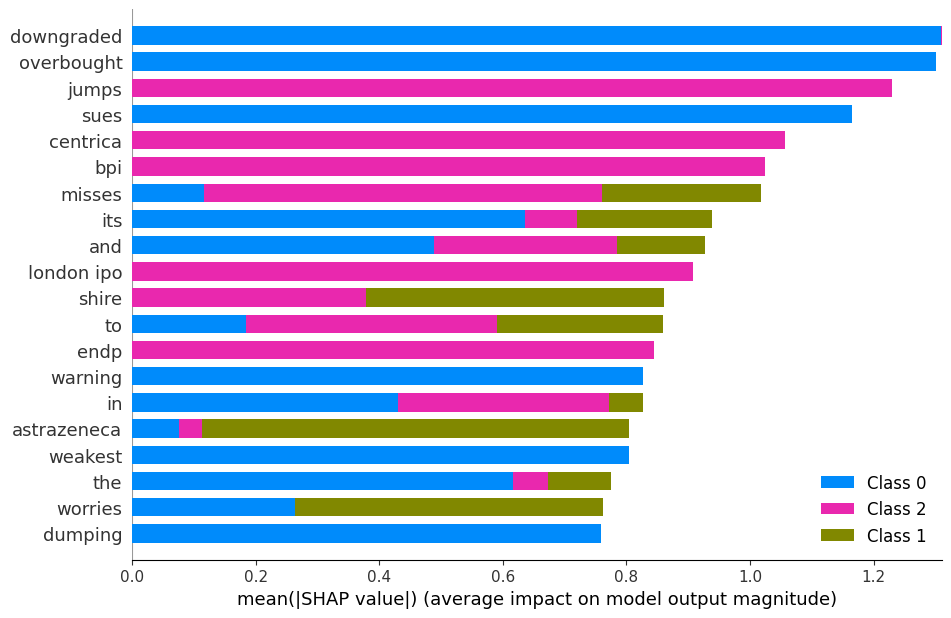


── LIME ► NEGATIVE (correct prediction)
[('stopped', -0.16072268024055417), ('number', -0.07748152524083858), ('surging', -0.0688783310973353), ('the', -0.06315994814781431), ('of', -0.05538378656728546), ('have', -0.021094054356058607), ('payments', -0.020336570470265738), ('is', -0.009968715769965417), ('u', 0.007511868248467221), ('homeowners', 0.005782907588337472)]

── LIME ► NEGATIVE (mis-classified as positive)
[('amazon', -0.2680166155536617), ('could', -0.07431127780153689), ('went', -0.06887683475007134), ('deliveries', -0.04938135594811281), ('said', -0.04267727737667887), ('asked', 0.04112763908701234), ('in', -0.04016391441471619), ('drone', -0.03880529171841283), ('bezos', -0.0354631130322387), ('inc', -0.030816999759390944)]

── LIME ► NEUTRAL (correct prediction)
[('the', 0.07744183369659462), ('chairman', 0.06814265993674025), ('of', 0.027882317468000344), ('board', 0.026942600866316706), ('elected', 0.017697512248823665), ('was', 0.014103809784889253), ('as', -0.0113

In [ ]:
# ==================================================================
# 10 – Explainability & Error analysis (SHAP · LIME · Stats)
# ==================================================================
import shap, lime.lime_text, re
from collections import Counter
import plotly.express as px
import plotly.figure_factory as ff
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# ------------------------------------------------------------------
# 10-A • SHAP  ► XGBoost   (Random Forest option désactivée)
# ------------------------------------------------------------------
print("=== SHAP analysis (XGBoost) ===")
xgb_explainer = shap.Explainer(xgb_best)                   # GPU-friendly
xgb_input     = X_test[:200].toarray().astype("float64")   # → dense
xgb_shap_vals = xgb_explainer(xgb_input)

shap.summary_plot(
    xgb_shap_vals, xgb_input,
    feature_names=vectorizer.get_feature_names_out(),
    max_display=20, show=False
)
plt.gcf().set_size_inches(10, 6)
plt.show()

# (décommenter si vous voulez vraiment lancer le RF – très long)
# ------------------------------------------------------------------
# print("=== SHAP analysis (Random Forest) ===")
# rf_explainer  = shap.TreeExplainer(rf_best)
# rf_input      = X_test[:200].toarray().astype("float64")
# rf_shap_vals  = rf_explainer(rf_input)
# shap.summary_plot(
#     rf_shap_vals, rf_input,
#     feature_names=vectorizer.get_feature_names_out(),
#     max_display=20, show=False
# )
# plt.gcf().set_size_inches(10, 6)
# plt.show()

# ------------------------------------------------------------------
# 10-B • LIME  ► Voting ensemble  (version robuste)
# ------------------------------------------------------------------
lime_explainer = lime.lime_text.LimeTextExplainer(class_names=classes)

def voting_proba(texts):
    return voting.predict_proba(vectorizer.transform(texts))

# --- Prédictions dans le même format que la colonne « label » -----
test_df["pred"] = le.inverse_transform(voting.predict(X_test))

# --- Sélection d’un exemple correct / faux par classe -------------
examples = {}
for lbl in classes:
    idx_ok  = test_df[(test_df["label"] == lbl) & (test_df["pred"] == lbl)].index
    idx_ko  = test_df[(test_df["label"] == lbl) & (test_df["pred"] != lbl)].index
    examples[lbl] = (idx_ok[0] if len(idx_ok) else None,
                     idx_ko[0] if len(idx_ko) else None)

for lbl, (i_ok, i_ko) in examples.items():
    if i_ok is not None:
        print(f"\n── LIME ► {lbl.upper()} (correct prediction)")
        txt = test_df.loc[i_ok, "input"]
        exp = lime_explainer.explain_instance(txt, voting_proba, num_features=10)
        print(exp.as_list())

    if i_ko is not None:
        print(f"\n── LIME ► {lbl.upper()} (mis-classified as {test_df.loc[i_ko,'pred']})")
        txt = test_df.loc[i_ko, "input"]
        exp = lime_explainer.explain_instance(txt, voting_proba, num_features=10)
        print(exp.as_list())

# ------------------------------------------------------------------
# 10-C • Analyse d’erreurs & statistiques
# ------------------------------------------------------------------
errors = test_df[test_df["label"] != test_df["pred"]]

print("\n=== Error patterns (truth → prediction) ===")
print(errors.groupby(["label", "pred"]).size()
          .reset_index(name="count")
          .sort_values("count", ascending=False))

print("\n=== Error rate by class ===")
for lbl in classes:
    tot = (test_df["label"] == lbl).sum()
    err = (errors["label"] == lbl).sum()
    print(f"{lbl:>8}: {err}/{tot}  ({err / tot * 100:.2f} %)")

def words(txt): return re.findall(r"\b\w+\b", txt.lower())
word_freq = Counter(w for txt in errors["input"] for w in words(txt))
print("\nTop 20 words in mis-classifications:")
print(word_freq.most_common(20))

# Histogramme longueur des textes -----------------------------------
test_df["len"]      = test_df["input"].str.len()
test_df["is_error"] = test_df["label"] != test_df["pred"]

fig_len = px.histogram(
    test_df, x="len", color="is_error", nbins=40, barmode="overlay",
    color_discrete_map={False: "#1f77b4", True: "#d62728"},
    labels={"len": "Text length", "is_error": "Mis-classified"}
)
fig_len.update_layout(title="Text length – Errors vs Correct")
fig_len.show()

# ------------------------------------------------------------------
# 10-D • Matrice de confusion (Plotly annotée)
# ------------------------------------------------------------------
cm     = confusion_matrix(test_df["label"], test_df["pred"], labels=classes)
cm_pct = np.divide(cm, cm.sum(axis=1, keepdims=True), out=np.zeros_like(cm, dtype=float), where=cm.sum(axis=1, keepdims=True) != 0) * 100

annot  = [[f"{cm[i,j]}<br>({cm_pct[i,j]:.1f} %)"
           for j in range(len(classes))]
           for i in range(len(classes))]

fig_cm = ff.create_annotated_heatmap(
    z=cm, x=list(classes), y=list(classes),
    annotation_text=annot, colorscale="Blues"
)
fig_cm.update_layout(
    title="Confusion Matrix – Voting Ensemble",
    xaxis_title="Predicted", yaxis_title="True",
    width=700, height=600
)
fig_cm.update_xaxes(side="bottom")
fig_cm.show()


In [ ]:
### 11 – Sauvegarde finale “meilleur modèle” + vectorizer
joblib.dump(voting, "lastbest_voting.joblib")
joblib.dump(vectorizer, "lasttfidf/tfidf_vect.joblib")
print("✓ Modèle et TF‑IDF sauvegardés.")


✓ Modèle et TF‑IDF sauvegardés.
